In [ ]:
from pyspark.sql.types import StructField, StructType, StringType, IntegerType, BooleanType, DateType
from pyspark.sql.functions import to_date, col, avg, sum, row_number, when
from pyspark.sql.window import Window

In [ ]:
from pyspark.sql import SparkSession

spark = SparkSession.builder.appName('IPL Data Analysis').getOrCreate()

In [ ]:
ball_by_ball_schema = StructType([
    StructField("MatcH_id", IntegerType(), True),
    StructField("Over_id", IntegerType(), True),
    StructField("Ball_id", IntegerType(), True),
    StructField("Innings_No", IntegerType(), True),
    StructField("Team_Batting", StringType(), True),
    StructField("Team_Bowling", StringType(), True),
    StructField("Striker_Batting_Position", IntegerType(), True),
    StructField("Extra_Type", StringType(), True),
    StructField("Runs_Scored", IntegerType(), True),
    StructField("Extra_runs", IntegerType(), True),
    StructField("Wides", IntegerType(), True),
    StructField("Legbyes", IntegerType(), True),
    StructField("Byes", IntegerType(), True),
    StructField("Noballs", IntegerType(), True),
    StructField("Penalty", IntegerType(), True),
    StructField("Bowler_Extras", IntegerType(), True),
    StructField("Out_type", StringType(), True),
    StructField("Caught", BooleanType(), True),
    StructField("Bowled", BooleanType(), True),
    StructField("Run_out", BooleanType(), True),
    StructField("LBW", BooleanType(), True),
    StructField("Retired_hurt", BooleanType(), True),
    StructField("Stumped", BooleanType(), True),
    StructField("caught_and_bowled", BooleanType(), True),
    StructField("hit_wicket", BooleanType(), True),
    StructField("ObstructingFeild", BooleanType(), True),
    StructField("Bowler_Wicket", IntegerType(), True),
    StructField("Match_Date", DateType(), True),
    StructField("Season", StringType(), True),
    StructField("Striker", StringType(), True),
    StructField("Non_Striker", StringType(), True),
    StructField("Bowler", StringType(), True),
    StructField("Player_Out", StringType(), True),
    StructField("Fielders", StringType(), True),
    StructField("Striker_match_SK", IntegerType(), True),
    StructField("StrikerSK", IntegerType(), True),
    StructField("NonStriker_match_SK", IntegerType(), True),
    StructField("NONStriker_SK", IntegerType(), True),
    StructField("Fielder_match_SK", IntegerType(), True),
    StructField("Fielder_SK", IntegerType(), True),
    StructField("Bowler_match_SK", IntegerType(), True),
    StructField("BOWLER_SK", IntegerType(), True),
    StructField("PlayerOut_match_SK", IntegerType(), True),
    StructField("BattingTeam_SK", IntegerType(), True),
    StructField("BowlingTeam_SK", IntegerType(), True),
    StructField("Keeper_Catch", IntegerType(), True),
    StructField("Player_out_sk", IntegerType(), True),
    StructField("MatchDateSK", IntegerType(), True)
])
ball_by_ball_df = spark.read.schema(ball_by_ball_schema).format("csv").option("header",True).load("s3://data-analysis/Ball_By_Ball.csv")
display(ball_by_ball_df)


MatcH_id,Over_id,Ball_id,Innings_No,Team_Batting,Team_Bowling,Striker_Batting_Position,Extra_Type,Runs_Scored,Extra_runs,Wides,Legbyes,Byes,Noballs,Penalty,Bowler_Extras,Out_type,Caught,Bowled,Run_out,LBW,Retired_hurt,Stumped,caught_and_bowled,hit_wicket,ObstructingFeild,Bowler_Wicket,Match_Date,Season,Striker,Non_Striker,Bowler,Player_Out,Fielders,Striker_match_SK,StrikerSK,NonStriker_match_SK,NONStriker_SK,Fielder_match_SK,Fielder_SK,Bowler_match_SK,BOWLER_SK,PlayerOut_match_SK,BattingTeam_SK,BowlingTeam_SK,Keeper_Catch,Player_out_sk,MatchDateSK
598028,15,6,1,5,2,6,No Extras,4,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,277,104,83,null,null,20336,276,20333,103,-1,-1,20343,82,-1,4,1,0,0,20130420
598028,14,1,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,104,6,346,null,null,20333,103,20328,5,-1,-1,20348,345,-1,4,1,0,0,20130420
598028,14,2,1,5,2,3,No Extras,1,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,0,0,20130420
598028,14,3,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,104,6,346,null,null,20333,103,20328,5,-1,-1,20348,345,-1,4,1,0,0,20130420
598028,14,4,1,5,2,3,No Extras,0,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,0,0,20130420
598028,14,5,1,5,2,3,No Extras,4,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,0,0,20130420
598028,14,6,1,5,2,3,No Extras,2,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,6,104,346,null,null,20328,5,20333,103,-1,-1,20348,345,-1,4,1,0,0,20130420
598028,13,1,1,5,2,5,No Extras,1,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,104,6,83,null,null,20333,103,20328,5,-1,-1,20343,82,-1,4,1,0,0,20130420
598028,13,2,1,5,2,3,No Extras,4,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,6,104,83,null,null,20328,5,20333,103,-1,-1,20343,82,-1,4,1,0,0,20130420
598028,13,3,1,5,2,3,No Extras,1,0,0,0,0,0,0,0,Not Applicable,null,null,null,null,null,null,null,null,null,0,null,2013,6,104,83,null,null,20328,5,20333,103,-1,-1,20343,82,-1,4,1,0,0,20130420


In [ ]:
match_df = spark.read.format("csv").option("header",True).option("inferSchema",True).load("s3://data-analysis/Match.csv")
match_df = match_df.withColumn("match_date", to_date(col("match_date"), "yyyy-MM-dd")).withColumn("Win_Margin", col("Win_Margin").cast("int"))
match_schema = StructType([
    StructField("Match_SK", IntegerType(), True),
    StructField("match_id", IntegerType(), True),
    StructField("Team1", StringType(), True),
    StructField("Team2", StringType(), True),
    StructField("match_date", DateType(), True),
    StructField("Season_Year", IntegerType(), True),
    StructField("Venue_Name", StringType(), True),
    StructField("City_Name", StringType(), True),
    StructField("Country_Name", StringType(), True),
    StructField("Toss_Winner", StringType(), True),
    StructField("match_winner", StringType(), True),
    StructField("Toss_Name", StringType(), True),
    StructField("Win_Type", StringType(), True),
    StructField("Outcome_Type", StringType(), True),
    StructField("ManOfMach", StringType(), True),
    StructField("Win_Margin", IntegerType(), True),
    StructField("Country_id", IntegerType(), True)
])
display(match_df)

Match_SK,match_id,Team1,Team2,match_date,Season_Year,Venue_Name,City_Name,Country_Name,Toss_Winner,match_winner,Toss_Name,Win_Type,Outcome_Type,ManOfMach,Win_Margin,Country_id
0,335987,Royal Challengers Bangalore,Kolkata Knight Riders,2008-04-18,2008,M Chinnaswamy Stadium,Bangalore,India,Royal Challengers Bangalore,Kolkata Knight Riders,field,runs,Result,BB McCullum,140,1
1,335988,Kings XI Punjab,Chennai Super Kings,2008-04-19,2008,"Punjab Cricket Association Stadium, Mohali",Chandigarh,India,Chennai Super Kings,Chennai Super Kings,bat,runs,Result,MEK Hussey,33,1
2,335989,Delhi Daredevils,Rajasthan Royals,2008-04-19,2008,Feroz Shah Kotla,Delhi,India,Rajasthan Royals,Delhi Daredevils,bat,wickets,Result,MF Maharoof,9,1
3,335990,Mumbai Indians,Royal Challengers Bangalore,2008-04-20,2008,Wankhede Stadium,Mumbai,India,Mumbai Indians,Royal Challengers Bangalore,bat,wickets,Result,MV Boucher,5,1
4,335991,Kolkata Knight Riders,Deccan Chargers,2008-04-20,2008,Eden Gardens,Kolkata,India,Deccan Chargers,Kolkata Knight Riders,bat,wickets,Result,DJ Hussey,5,1
5,335992,Rajasthan Royals,Kings XI Punjab,2008-04-21,2008,Sawai Mansingh Stadium,Jaipur,India,Kings XI Punjab,Rajasthan Royals,bat,wickets,Result,SR Watson,6,1
6,335993,Deccan Chargers,Delhi Daredevils,2008-04-22,2008,"Rajiv Gandhi International Stadium, Uppal",Hyderabad,India,Deccan Chargers,Delhi Daredevils,bat,wickets,Result,V Sehwag,9,1
7,335994,Chennai Super Kings,Mumbai Indians,2008-04-23,2008,"MA Chidambaram Stadium, Chepauk",Chennai,India,Mumbai Indians,Chennai Super Kings,field,runs,Result,ML Hayden,6,1
8,335995,Deccan Chargers,Rajasthan Royals,2008-04-24,2008,"Rajiv Gandhi International Stadium, Uppal",Hyderabad,India,Rajasthan Royals,Rajasthan Royals,field,wickets,Result,YK Pathan,3,1
9,335996,Kings XI Punjab,Mumbai Indians,2008-04-25,2008,"Punjab Cricket Association Stadium, Mohali",Chandigarh,India,Mumbai Indians,Kings XI Punjab,field,runs,Result,KC Sangakkara,66,1


In [ ]:
player_match_df = spark.read.format("csv").option("header",True).option("inferSchema",True).load("s3://data-analysis/Player_match.csv")
# player_mat_first_row = player_match_df.limit(1)
# display(player_mat_first_row)
# player_match_df = player_match_df.subtract(player_mat_first_row)
player_match_df = player_match_df.na.drop(thresh=(player_match_df.columns.__len__() - 10))
player_match_df = player_match_df.withColumn("DOB", to_date(col("DOB"), "yyyy-MM-dd")) \
                                 .withColumn("PlayerMatch_key", col("PlayerMatch_key").cast("int")) \
                                 .withColumn("is_manofThematch", col("is_manofThematch").cast("boolean")) \
                                 .withColumn("IsPlayers_Team_won", col("IsPlayers_Team_won").cast("boolean"))
display(player_match_df)

Player_match_SK,PlayerMatch_key,Match_Id,Player_Id,Player_Name,DOB,Batting_hand,Bowling_skill,Country_Name,Role_Desc,Player_team,Opposit_Team,Season_year,is_manofThematch,Age_As_on_match,IsPlayers_Team_won,Batting_Status,Bowling_Status,Player_Captain,Opposit_captain,Player_keeper,Opposit_keeper
12694,2147483647,335987,6,R Dravid,1973-01-11,Right-hand bat,Right-arm offbreak,India,Captain,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,35,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12695,2147483647,335987,7,W Jaffer,1978-02-16,Right-hand bat,Right-arm offbreak,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,30,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12696,2147483647,335987,8,V Kohli,1988-11-05,Right-hand bat,Right-arm medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,20,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12697,2147483647,335987,9,JH Kallis,1975-10-16,Right-hand bat,Right-arm fast-medium,South Africa,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,33,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12698,2147483647,335987,10,CL White,1983-08-18,Right-hand bat,Legbreak googly,Australia,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,25,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12699,2147483647,335987,11,MV Boucher,1976-12-03,Right-hand bat,Right-arm medium,South Africa,Keeper,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,32,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12700,2147483647,335987,12,B Akhil,1977-10-07,Right-hand bat,Right-arm medium-fast,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,31,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12701,2147483647,335987,13,AA Noffke,1977-04-30,Right-hand bat,Right-arm fast-medium,Australia,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,31,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12702,2147483647,335987,14,P Kumar,1986-10-02,Right-hand bat,Right-arm medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,22,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha
12703,2147483647,335987,15,Z Khan,1978-10-07,Right-hand bat,Left-arm fast-medium,India,Player,Royal Challengers Bangalore,Kolkata Knight Riders,2008,false,30,false,null,null,R Dravid,SC Ganguly,MV Boucher,WP Saha


In [ ]:
player_df = spark.read.format("csv").option("header",True).option("inferSchema",True).load("s3://data-analysis/Player.csv")
player_df = player_df.withColumn("DOB", to_date(col("DOB"), "yyyy-MM-dd"))
display(player_df)

PLAYER_SK,Player_Id,Player_Name,DOB,Batting_hand,Bowling_skill,Country_Name
0,1,SC Ganguly,1972-07-08,Left-hand bat,Right-arm medium,India
1,2,BB McCullum,1981-09-27,Right-hand bat,Right-arm medium,New Zealand
2,3,RT Ponting,1974-12-19,Right-hand bat,Right-arm medium,Australia
3,4,DJ Hussey,1977-07-15,Right-hand bat,Right-arm offbreak,Australia
4,5,Mohammad Hafeez,1980-10-17,Right-hand bat,Right-arm offbreak,Pakistan
5,6,R Dravid,1973-01-11,Right-hand bat,Right-arm offbreak,India
6,7,W Jaffer,1978-02-16,Right-hand bat,Right-arm offbreak,India
7,8,V Kohli,1988-11-05,Right-hand bat,Right-arm medium,India
8,9,JH Kallis,1975-10-16,Right-hand bat,Right-arm fast-medium,South Africa
9,10,CL White,1983-08-18,Right-hand bat,Legbreak googly,Australia


In [ ]:
team_df = spark.read.format("csv").option("header",True).option("inferSchema",True).load("s3://data-analysis/Team.csv")
display(team_df)

Team_SK,Team_Id,Team_Name
0,1,Kolkata Knight Riders
1,2,Royal Challengers Bangalore
2,3,Chennai Super Kings
3,4,Kings XI Punjab
4,5,Rajasthan Royals
5,6,Delhi Daredevils
6,7,Mumbai Indians
7,8,Deccan Chargers
8,9,Kochi Tuskers Kerala
9,10,Pune Warriors


In [ ]:
# filter dataframe
ball_by_ball_df = ball_by_ball_df.filter((col("Wides")==0) & (col("Noballs")==0))
# display(ball_by_ball_df)
  
# aggregation total and avg
total_avg_runs = ball_by_ball_df.groupBy('MatcH_id','Innings_No').agg(sum(col("Runs_Scored")).alias('Total Runs'),avg(col("Runs_Scored")).alias('AVG')).orderBy('Match_id','Innings_No')
display(total_avg_runs)
# display(ball_by_ball_df)

MatcH_id,Innings_No,Total Runs,AVG
335987,1,205,1.7083333333333333
335987,2,63,0.6923076923076923
335988,1,230,1.9166666666666667
335988,2,196,1.6333333333333333
335989,1,118,0.9833333333333333
335989,2,122,1.3406593406593406
335990,1,154,1.2833333333333334
335990,2,161,1.3644067796610169
335991,1,100,0.8928571428571429
335991,2,84,0.7368421052631579


In [ ]:
#  window function to get running total of run s in each inning
win = Window.partitionBy('Match_id','Innings_No').orderBy('Over_id')
ball_by_ball_df = ball_by_ball_df.withColumn('running_total_runs', sum('Runs_scored').over(win))


In [ ]:
# Conditional Column: Flag for high impact balls (either a wicket or more than 6 runs including extras)
ball_by_ball_df = ball_by_ball_df.withColumn('impact_balls', when((col('Runs_scored')+col('Extra_runs') >6) | (col('Bowler_wicket')==True), True).otherwise(False))
ball_by_ball_df.show(2)

+--------+-------+-------+----------+------------+------------+------------------------+----------+-----------+----------+-----+-------+----+-------+-------+-------------+--------------+------+------+-------+----+------------+-------+-----------------+----------+----------------+-------------+----------+------+-------+-----------+------+----------+--------+----------------+---------+-------------------+-------------+----------------+----------+---------------+---------+------------------+--------------+--------------+------------+-------------+-----------+------------------+------------+
|MatcH_id|Over_id|Ball_id|Innings_No|Team_Batting|Team_Bowling|Striker_Batting_Position|Extra_Type|Runs_Scored|Extra_runs|Wides|Legbyes|Byes|Noballs|Penalty|Bowler_Extras|      Out_type|Caught|Bowled|Run_out| LBW|Retired_hurt|Stumped|caught_and_bowled|hit_wicket|ObstructingFeild|Bowler_Wicket|Match_Date|Season|Striker|Non_Striker|Bowler|Player_Out|Fielders|Striker_match_SK|StrikerSK|NonStriker_match_SK

In [ ]:
from pyspark.sql.functions import year, month, dayofmonth, when

# Extracting year, month, and day from the match date for more detailed time-based analysis
match_df = match_df.withColumn('Year', year(col('match_date'))) \
                    .withColumn('Month', month(col('match_date'))) \
                    .withColumn('Day', dayofmonth(col('match_date')))

# High margin win: categorizing win margins into 'high', 'medium', and 'low'
match_df = match_df.withColumn('win_margin_category', when(col('Win_Margin')>100,'High')
                               .when((col('Win_Margin')>50) & (col('Win_Margin')<100),'Medium')
                               .otherwise('Low'))

# Analyze the impact of the toss: who wins the toss and the match
match_df = match_df.withColumn('toss_match_winner', 
                               when(col('Toss_Winner')==col('match_winner'),'Yes')
                               .otherwise('No')
                               )

match_df.show(2)

+--------+--------+--------------------+--------------------+----------+-----------+--------------------+----------+------------+--------------------+--------------------+---------+--------+------------+-----------+----------+----------+----+-----+---+-------------------+-----------------+
|Match_SK|match_id|               Team1|               Team2|match_date|Season_Year|          Venue_Name| City_Name|Country_Name|         Toss_Winner|        match_winner|Toss_Name|Win_Type|Outcome_Type|  ManOfMach|Win_Margin|Country_id|Year|Month|Day|win_margin_category|toss_match_winner|
+--------+--------+--------------------+--------------------+----------+-----------+--------------------+----------+------------+--------------------+--------------------+---------+--------+------------+-----------+----------+----------+----+-----+---+-------------------+-----------------+
|       0|  335987|Royal Challengers...|Kolkata Knight Ri...|2008-04-18|       2008|M Chinnaswamy Sta...| Bangalore|       Indi

In [ ]:
from pyspark.sql.functions import regexp_replace, lower

player_df = player_df.withColumn('Player_Name', lower(regexp_replace("Player_Name","[^a-zA-Z0-9 ]","")))

# Handle missing values in 'batting_hand' and 'bowling_skill' with a default 'unknown'
player_df = player_df.na.fill({'Batting_hand':'unknown','Bowling_skill':'unknown'})

# Categorizing players based on batting hand
player_df = player_df.withColumn('batting_style', when(lower(col('Batting_hand')).contains('left'),'Left-Handed')
                                 .otherwise('Right-Handed'))

player_df.show(5)


+---------+---------+---------------+----------+--------------+------------------+------------+-------------+
|PLAYER_SK|Player_Id|    Player_Name|       DOB|  Batting_hand|     Bowling_skill|Country_Name|batting_style|
+---------+---------+---------------+----------+--------------+------------------+------------+-------------+
|        0|        1|     sc ganguly|1972-07-08| Left-hand bat|  Right-arm medium|       India|  Left-Handed|
|        1|        2|    bb mccullum|1981-09-27|Right-hand bat|  Right-arm medium| New Zealand| Right-Handed|
|        2|        3|     rt ponting|1974-12-19|Right-hand bat|  Right-arm medium|   Australia| Right-Handed|
|        3|        4|      dj hussey|1977-07-15|Right-hand bat|Right-arm offbreak|   Australia| Right-Handed|
|        4|        5|mohammad hafeez|1980-10-17|Right-hand bat|Right-arm offbreak|    Pakistan| Right-Handed|
+---------+---------+---------------+----------+--------------+------------------+------------+-------------+
only showi

In [ ]:
from pyspark.sql.functions import year, current_date

# Add a 'veteran_status' column based on player age
player_match_df.show(1)
player_match_df = player_match_df.withColumn('veteran_status', when(col('Age_As_on_match')>=35,'Veteran')
                                             .otherwise('Non-Veteran'))

# Dynamic column to calculate years since debut
player_match_df = player_match_df.withColumn('year_since_debut', year(current_date())-col('Season_year'))
player_match_df.show(1)

+---------------+---------------+--------+---------+-----------+----------+--------------+------------------+------------+---------+--------------------+--------------------+-----------+----------------+---------------+------------------+--------------+--------------+--------------+---------------+-------------+--------------+
|Player_match_SK|PlayerMatch_key|Match_Id|Player_Id|Player_Name|       DOB|  Batting_hand|     Bowling_skill|Country_Name|Role_Desc|         Player_team|        Opposit_Team|Season_year|is_manofThematch|Age_As_on_match|IsPlayers_Team_won|Batting_Status|Bowling_Status|Player_Captain|Opposit_captain|Player_keeper|Opposit_keeper|
+---------------+---------------+--------+---------+-----------+----------+--------------+------------------+------------+---------+--------------------+--------------------+-----------+----------------+---------------+------------------+--------------+--------------+--------------+---------------+-------------+--------------+
|          12

In [ ]:
ball_by_ball_df.createOrReplaceTempView("ball_by_ball")
match_df.createOrReplaceTempView("match")
player_df.createOrReplaceTempView("player")
player_match_df.createOrReplaceTempView("player_match")
team_df.createOrReplaceTempView("team")
# ball_by_ball_df.columns
# match_df.columns
# player_df.columns
player_match_df.columns

Out[14]: ['Player_match_SK',
 'PlayerMatch_key',
 'Match_Id',
 'Player_Id',
 'Player_Name',
 'DOB',
 'Batting_hand',
 'Bowling_skill',
 'Country_Name',
 'Role_Desc',
 'Player_team',
 'Opposit_Team',
 'Season_year',
 'is_manofThematch',
 'Age_As_on_match',
 'IsPlayers_Team_won',
 'Batting_Status',
 'Bowling_Status',
 'Player_Captain',
 'Opposit_captain',
 'Player_keeper',
 'Opposit_keeper',
 'veteran_status',
 'year_since_debut']

In [ ]:
top_scoring_batsmen_per_season = spark.sql("""
select p.Player_Name, m.Season_year, sum(Runs_scored) as total_runs
from ball_by_ball b
join match m on m.match_id=b.MatcH_id
join player_match pm on pm.Match_Id=m.match_id and b.striker=pm.Player_Id
join player p on p.Player_Id=pm.Player_Id
group by p.Player_Name, m.Season_year
order by m.Season_year, total_runs desc
"""
)
top_scoring_batsmen_per_season.show(30)

+---------------+-----------+----------+
|    Player_Name|Season_year|total_runs|
+---------------+-----------+----------+
|       se marsh|       2008|       614|
|      g gambhir|       2008|       532|
|  st jayasuriya|       2008|       508|
|      sr watson|       2008|       463|
|       gc smith|       2008|       437|
|   ac gilchrist|       2008|       431|
|      yk pathan|       2008|       430|
|       sk raina|       2008|       420|
|       ms dhoni|       2008|       414|
|       v sehwag|       2008|       399|
|      rg sharma|       2008|       399|
|       r dravid|       2008|       370|
|     sc ganguly|       2008|       349|
|       s dhawan|       2008|       340|
|  kc sangakkara|       2008|       319|
|      dj hussey|       2008|       318|
|     rv uthappa|       2008|       316|
|    sa asnodkar|       2008|       311|
|   yuvraj singh|       2008|       299|
|       pa patel|       2008|       297|
|y venugopal rao|       2008|       283|
|      ja morkel

In [ ]:
economical_bowlers_powerplay = spark.sql("""
SELECT 
p.player_name, 
AVG(b.runs_scored) AS avg_runs_per_ball, 
COUNT(b.bowler_wicket) AS total_wickets
FROM ball_by_ball b
JOIN player_match pm ON b.match_id = pm.match_id AND b.bowler = pm.player_id
JOIN player p ON pm.player_id = p.player_id
WHERE b.over_id <= 6
GROUP BY p.player_name
HAVING COUNT(*) >= 1
ORDER BY avg_runs_per_ball, total_wickets DESC
""")
economical_bowlers_powerplay.show()

+---------------+------------------+-------------+
|    player_name| avg_runs_per_ball|total_wickets|
+---------------+------------------+-------------+
|     sm harwood|0.3333333333333333|           18|
|     avesh khan|               0.5|           12|
|     ankit soni|               0.5|            6|
|      gr napier|               0.5|            6|
|       aj finch|               0.5|            6|
|        a zampa|               0.5|            6|
|       nb singh|0.5833333333333334|           24|
|     ag murtaza|0.6538461538461539|           78|
|      sb bangar|0.6666666666666666|           18|
|     d du preez|0.6666666666666666|           18|
|        s gopal|0.6666666666666666|            6|
|     fh edwards|0.6923076923076923|           78|
|       a kumble|0.7685185185185185|          108|
|       umar gul|0.7777777777777778|           36|
|j syed mohammad|0.7777777777777778|           18|
|   kp pietersen|0.7777777777777778|           18|
|    rj peterson|0.833333333333

In [ ]:

toss_impact_individual_matches = spark.sql("""
SELECT m.match_id, m.toss_winner, m.toss_name, m.match_winner,
       CASE WHEN m.toss_winner = m.match_winner THEN 'Won' ELSE 'Lost' END AS match_outcome
FROM match m
WHERE m.toss_name IS NOT NULL
ORDER BY m.match_id
""")
toss_impact_individual_matches.show()

+--------+--------------------+---------+--------------------+-------------+
|match_id|         toss_winner|toss_name|        match_winner|match_outcome|
+--------+--------------------+---------+--------------------+-------------+
|  335987|Royal Challengers...|    field|Kolkata Knight Ri...|         Lost|
|  335988| Chennai Super Kings|      bat| Chennai Super Kings|          Won|
|  335989|    Rajasthan Royals|      bat|    Delhi Daredevils|         Lost|
|  335990|      Mumbai Indians|      bat|Royal Challengers...|         Lost|
|  335991|     Deccan Chargers|      bat|Kolkata Knight Ri...|         Lost|
|  335992|     Kings XI Punjab|      bat|    Rajasthan Royals|         Lost|
|  335993|     Deccan Chargers|      bat|    Delhi Daredevils|         Lost|
|  335994|      Mumbai Indians|    field| Chennai Super Kings|         Lost|
|  335995|    Rajasthan Royals|    field|    Rajasthan Royals|          Won|
|  335996|      Mumbai Indians|    field|     Kings XI Punjab|         Lost|

In [ ]:

average_runs_in_wins = spark.sql("""
SELECT p.player_name, AVG(b.runs_scored) AS avg_runs_in_wins, COUNT(*) AS innings_played
FROM ball_by_ball b
JOIN player_match pm ON b.match_id = pm.match_id AND b.striker = pm.player_id
JOIN player p ON pm.player_id = p.player_id
JOIN match m ON pm.match_id = m.match_id
WHERE m.match_winner = pm.player_team
GROUP BY p.player_name
ORDER BY avg_runs_in_wins ASC
""")
average_runs_in_wins.show()


+--------------+-------------------+--------------+
|   player_name|   avg_runs_in_wins|innings_played|
+--------------+-------------------+--------------+
|       a nehra|                0.0|             2|
|    kp appanna|                0.0|             1|
|     jj bumrah|                0.0|             2|
|      i sharma|                0.0|             1|
|      ts mills|                0.0|             3|
|      j theron|                0.0|             1|
|      vr aaron|                0.0|             5|
|     sn thakur|                0.0|             2|
| anirudh singh|                0.0|             1|
|    t thushara|                0.2|             5|
|     sa abbott|               0.25|             4|
| yashpal singh| 0.3157894736842105|            19|
|   s sreesanth| 0.3333333333333333|             3|
|   kc cariappa| 0.3333333333333333|             3|
|    jd unadkat|                0.4|             5|
|    sm harwood|0.42857142857142855|             7|
|      r shu

In [ ]:

import matplotlib.pyplot as plt

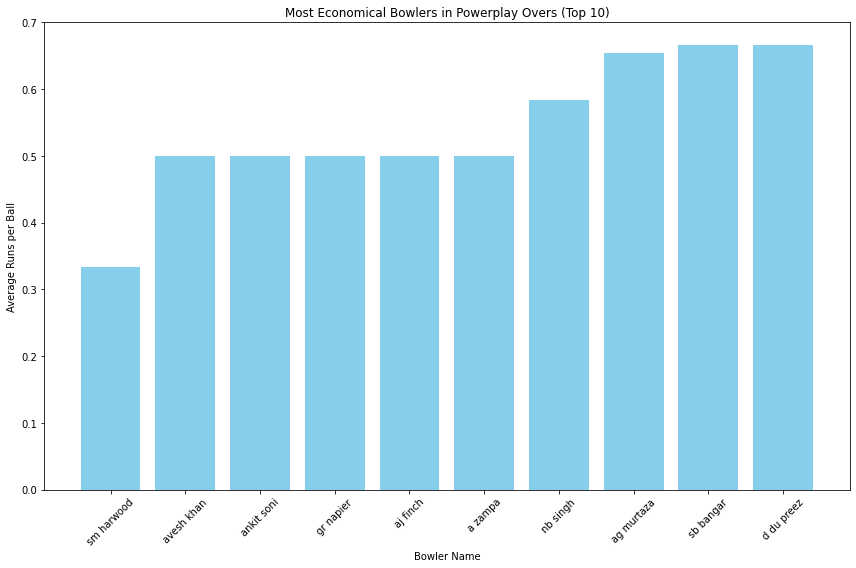

In [ ]:

# Assuming 'economical_bowlers_powerplay' is already executed and available as a Spark DataFrame
economical_bowlers_pd = economical_bowlers_powerplay.toPandas()

# Visualizing using Matplotlib
plt.figure(figsize=(12, 8))
# Limiting to top 10 for clarity in the plot
top_economical_bowlers = economical_bowlers_pd.nsmallest(10, 'avg_runs_per_ball')
plt.bar(top_economical_bowlers['player_name'], top_economical_bowlers['avg_runs_per_ball'], color='skyblue')
plt.xlabel('Bowler Name')
plt.ylabel('Average Runs per Ball')
plt.title('Most Economical Bowlers in Powerplay Overs (Top 10)')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()